# AlphaEarth Embedding Analysis - Somerset, UK

This notebook replicates the analysis techniques from [Element84's AlphaEarth Embeddings blog post](https://element84.com/machine-learning/exploring-alphaearth-embeddings/).

**Dataset:** Google AlphaEarth embeddings for Somerset, UK
- **2018:** `xbckr5wa0l2omaauu-0000008192-0000000000.tiff`
- **2024:** `xks7764uu0jo1h8jh-0000008192-0000000000.tiff`

**Techniques covered:**
1. False Color Visualization
2. Individual Dimension Exploration
3. PCA Dimensionality Reduction
4. K-Means Clustering
5. Cosine Similarity Search
6. Change Detection (2018 → 2024)

## 1. Setup and Data Loading

In [16]:
import numpy as np
import rasterio
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics.pairwise import cosine_similarity
from scipy import ndimage
import warnings
warnings.filterwarnings('ignore')

# Set up plotting style
plt.rcParams['figure.figsize'] = [12, 8]
plt.rcParams['figure.dpi'] = 100

In [17]:
# File paths
TIFF_2018 = "../input_data/xbckr5wa0l2omaauu-0000008192-0000000000.tiff"
TIFF_2024 = "../input_data/xks7764uu0jo1h8jh-0000008192-0000000000.tiff"

# De-quantization function for AlphaEarth int8 embeddings
def dequantize(values, nodata_value=-128):
    """
    Convert int8 AlphaEarth embeddings [-127, 127] to float [-1, 1].
    Formula: ((value / 127.5) ** 2) * sign(value)
    NoData (-128) becomes NaN.
    """
    nodata_mask = values == nodata_value
    values_float = values.astype(np.float32)
    result = ((values_float / 127.5) ** 2) * np.sign(values_float)
    result[nodata_mask] = np.nan
    return result

# Z-normalization for better visualization
def z_normalize(arr, sigma=3.0):
    """Z-normalize and clip to sigma standard deviations."""
    mean = np.nanmean(arr)
    std = np.nanstd(arr)
    if std == 0:
        return np.zeros_like(arr)
    z = (arr - mean) / std
    return np.clip(z, -sigma, sigma)

# Normalize to [0, 1] for display
def normalize_display(arr):
    """Normalize array to [0, 1] for display."""
    min_val, max_val = np.nanmin(arr), np.nanmax(arr)
    if max_val - min_val == 0:
        return np.zeros_like(arr)
    return (arr - min_val) / (max_val - min_val)

In [18]:
# Load embeddings from both years with DOWNSAMPLING for memory efficiency
# Adjust DOWNSAMPLE_FACTOR based on your available RAM:
#   1 = full resolution (~17GB per year) - requires 64GB+ RAM
#   2 = half resolution (~4GB per year) - requires 16GB+ RAM  
#   4 = quarter resolution (~1GB per year) - works on 8GB RAM ✓
#   8 = 1/8 resolution (~256MB per year) - very fast, lower detail

DOWNSAMPLE_FACTOR = 4  # Recommended for 16GB MacBook

def load_embeddings(filepath, downsample=1):
    """Load GeoTIFF with optional downsampling for memory efficiency."""
    with rasterio.open(filepath) as src:
        if downsample > 1:
            # Read at reduced resolution
            data = src.read(
                out_shape=(src.count, src.height // downsample, src.width // downsample),
                resampling=rasterio.enums.Resampling.nearest
            )
        else:
            data = src.read()
        profile = src.profile.copy()
        bounds = src.bounds
    # Transpose to (height, width, 64)
    embeddings = np.transpose(data, (1, 2, 0))
    
    # Flip vertically so North is at the top (GeoTIFFs often have origin at bottom-left)
    embeddings = np.flipud(embeddings)
    
    return embeddings, profile, bounds

print(f"Loading with {DOWNSAMPLE_FACTOR}x downsampling (every {DOWNSAMPLE_FACTOR}th pixel)...")
print(f"Output resolution: {8192//DOWNSAMPLE_FACTOR} x {8192//DOWNSAMPLE_FACTOR}")
print(f"Estimated memory per year: ~{(8192//DOWNSAMPLE_FACTOR)**2 * 64 * 4 / 1e9:.2f} GB\n")

print("Loading 2018 embeddings...")
emb_2018_raw, profile_2018, bounds = load_embeddings(TIFF_2018, DOWNSAMPLE_FACTOR)
print("Loading 2024 embeddings...")
emb_2024_raw, profile_2024, _ = load_embeddings(TIFF_2024, DOWNSAMPLE_FACTOR)

print(f"\nShape: {emb_2018_raw.shape}")
print(f"Data type: {emb_2018_raw.dtype}")
print(f"Bounds: {bounds}")
print(f"CRS: {profile_2018['crs']}")
print(f"Memory usage: ~{emb_2018_raw.nbytes * 2 / 1e9:.2f} GB total (both years, before de-quantization)")

Loading with 4x downsampling (every 4th pixel)...
Output resolution: 2048 x 2048
Estimated memory per year: ~1.07 GB

Loading 2018 embeddings...
Loading 2024 embeddings...
Loading 2024 embeddings...

Shape: (2048, 2048, 64)
Data type: int8
Bounds: BoundingBox(left=500000.0, bottom=5734400.0, right=581920.0, top=5652480.0)
CRS: EPSG:32630
Memory usage: ~0.54 GB total (both years, before de-quantization)

Shape: (2048, 2048, 64)
Data type: int8
Bounds: BoundingBox(left=500000.0, bottom=5734400.0, right=581920.0, top=5652480.0)
CRS: EPSG:32630
Memory usage: ~0.54 GB total (both years, before de-quantization)


In [19]:
# De-quantize embeddings to float
print("De-quantizing embeddings...")
emb_2018 = dequantize(emb_2018_raw)
emb_2024 = dequantize(emb_2024_raw)

# Create valid pixel mask (no NaN in any dimension)
valid_mask = ~np.isnan(emb_2018).any(axis=2) & ~np.isnan(emb_2024).any(axis=2)
print(f"Valid pixels: {valid_mask.sum():,} / {valid_mask.size:,} ({100*valid_mask.sum()/valid_mask.size:.1f}%)")

# Check value ranges
print(f"\n2018 embedding range: [{np.nanmin(emb_2018):.4f}, {np.nanmax(emb_2018):.4f}]")
print(f"2024 embedding range: [{np.nanmin(emb_2024):.4f}, {np.nanmax(emb_2024):.4f}]")

De-quantizing embeddings...
Valid pixels: 4,194,304 / 4,194,304 (100.0%)

2018 embedding range: [-0.4873, 0.4656]
2024 embedding range: [-0.5094, 0.4340]
Valid pixels: 4,194,304 / 4,194,304 (100.0%)

2018 embedding range: [-0.4873, 0.4656]
2024 embedding range: [-0.5094, 0.4340]


## 2. False Color Visualization

Create RGB composites by selecting 3 of the 64 embedding dimensions. Different dimension combinations reveal different features in the landscape.

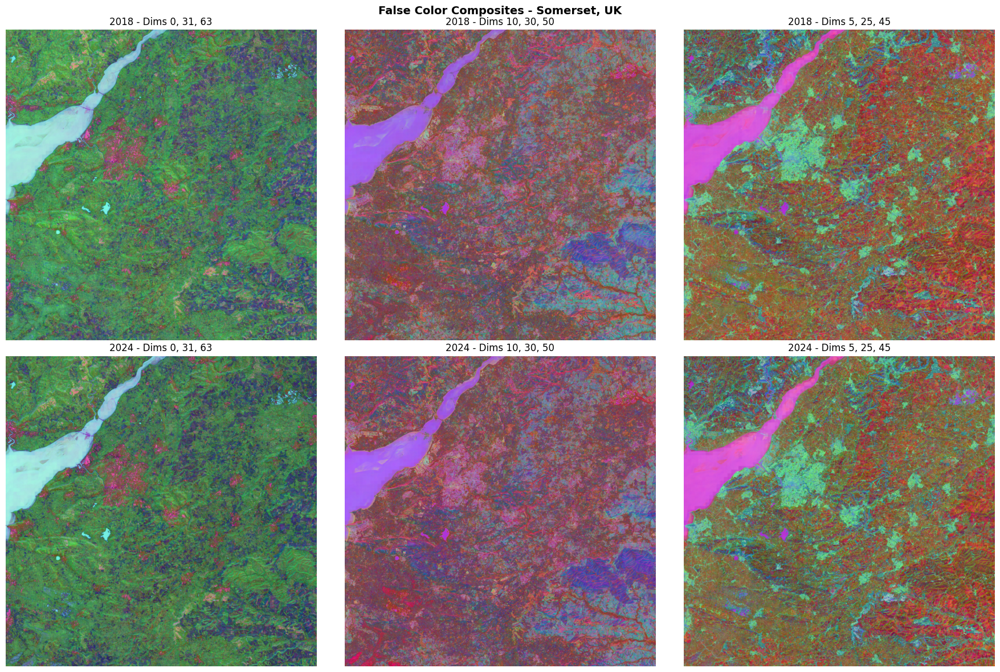

In [20]:
def create_false_color(embeddings, r_dim=0, g_dim=31, b_dim=63):
    """Create RGB false color composite from 3 embedding dimensions."""
    rgb = np.stack([
        embeddings[:, :, r_dim],
        embeddings[:, :, g_dim],
        embeddings[:, :, b_dim]
    ], axis=-1)
    # Normalize each channel to [0, 1]
    for i in range(3):
        rgb[:, :, i] = normalize_display(rgb[:, :, i])
    return rgb

# Create false color composites
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Different dimension combinations
dim_combos = [
    (0, 31, 63, "Dims 0, 31, 63"),
    (10, 30, 50, "Dims 10, 30, 50"),
    (5, 25, 45, "Dims 5, 25, 45"),
]

for idx, (r, g, b, title) in enumerate(dim_combos):
    # 2018
    rgb_2018 = create_false_color(emb_2018, r, g, b)
    axes[0, idx].imshow(rgb_2018)
    axes[0, idx].set_title(f"2018 - {title}")
    axes[0, idx].axis('off')
    
    # 2024
    rgb_2024 = create_false_color(emb_2024, r, g, b)
    axes[1, idx].imshow(rgb_2024)
    axes[1, idx].set_title(f"2024 - {title}")
    axes[1, idx].axis('off')

plt.suptitle("False Color Composites - Somerset, UK", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

## 3. Individual Dimension Exploration

Each of the 64 dimensions encodes different landscape features. The Element84 blog found:
- **Dimension 26**: Airports
- **Dimension 51**: Industrial areas
- **Dimensions 6, 20, 24**: Tall buildings
- Various dimensions for water, vegetation, urban areas

Let's explore what different dimensions capture in Somerset.

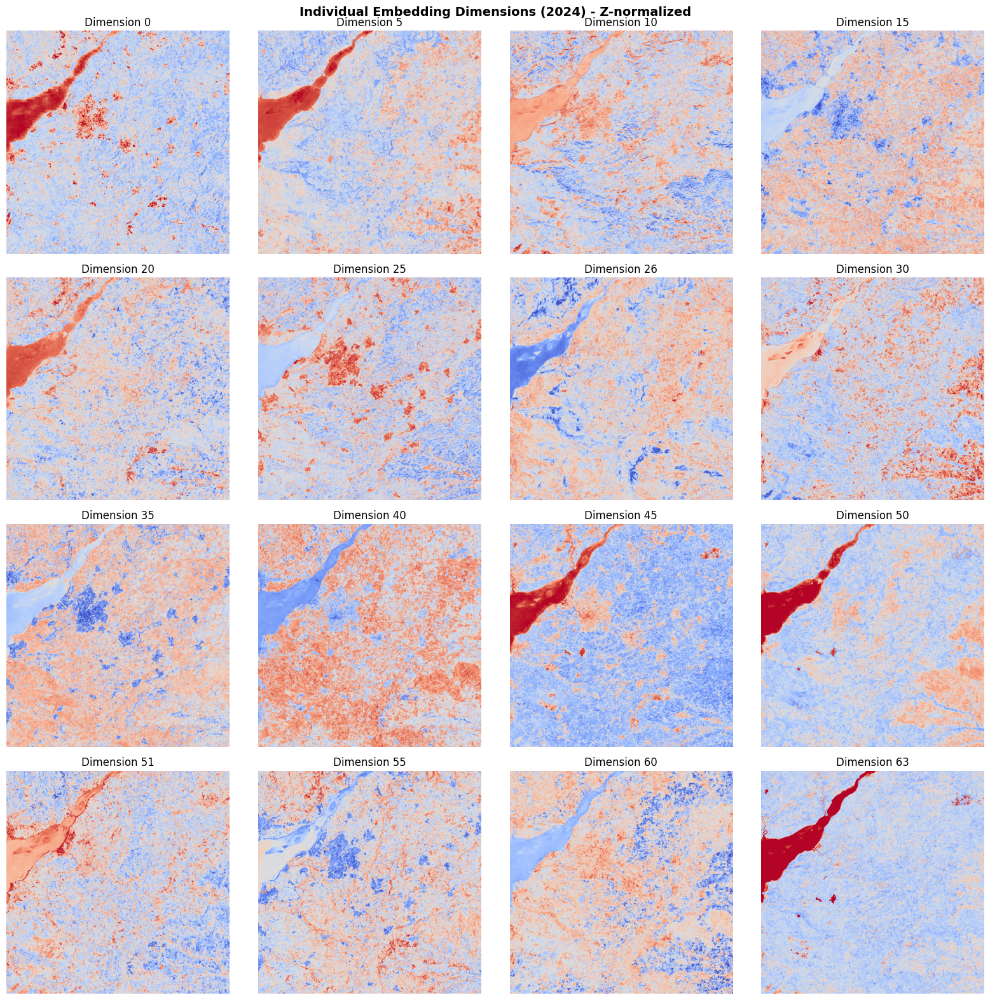

In [21]:
# Visualize a grid of individual dimensions (2024 data)
fig, axes = plt.subplots(4, 4, figsize=(16, 16))
dims_to_show = [0, 5, 10, 15, 20, 25, 26, 30, 35, 40, 45, 50, 51, 55, 60, 63]

for idx, dim in enumerate(dims_to_show):
    ax = axes[idx // 4, idx % 4]
    dim_data = z_normalize(emb_2024[:, :, dim])
    im = ax.imshow(dim_data, cmap='coolwarm')
    ax.set_title(f"Dimension {dim}")
    ax.axis('off')

plt.suptitle("Individual Embedding Dimensions (2024) - Z-normalized", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

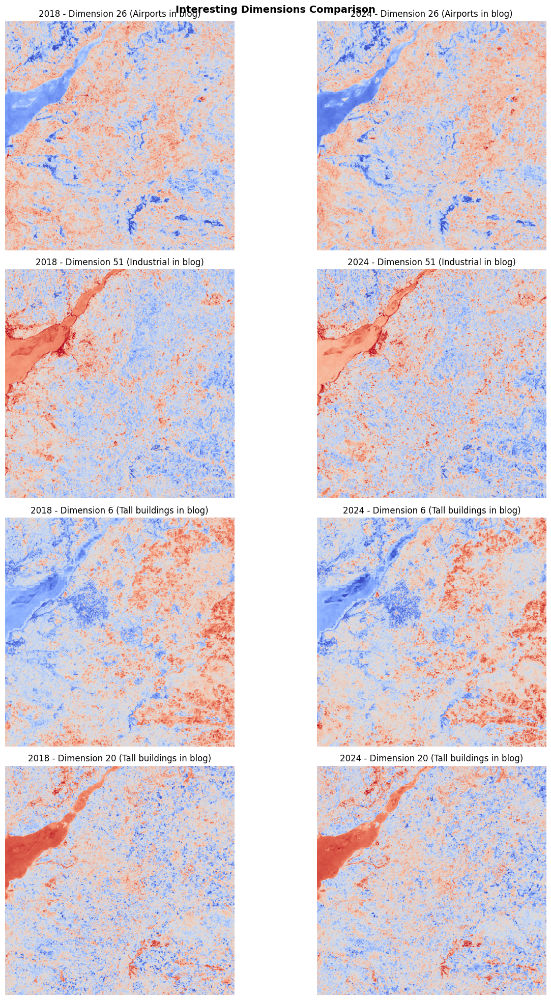

In [22]:
# Compare specific interesting dimensions between 2018 and 2024
interesting_dims = [
    (26, "Dimension 26 (Airports in blog)"),
    (51, "Dimension 51 (Industrial in blog)"),
    (6, "Dimension 6 (Tall buildings in blog)"),
    (20, "Dimension 20 (Tall buildings in blog)"),
]

fig, axes = plt.subplots(len(interesting_dims), 2, figsize=(14, 5*len(interesting_dims)))

for idx, (dim, label) in enumerate(interesting_dims):
    # 2018
    axes[idx, 0].imshow(z_normalize(emb_2018[:, :, dim]), cmap='coolwarm')
    axes[idx, 0].set_title(f"2018 - {label}")
    axes[idx, 0].axis('off')
    
    # 2024
    axes[idx, 1].imshow(z_normalize(emb_2024[:, :, dim]), cmap='coolwarm')
    axes[idx, 1].set_title(f"2024 - {label}")
    axes[idx, 1].axis('off')

plt.suptitle("Interesting Dimensions Comparison", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

## 4. PCA Dimensionality Reduction

Reduce the 64 embedding dimensions to 3 principal components and visualize as RGB. This provides a natural color scheme that highlights the main variation in the data.

In [23]:
# PCA fitting - adjusted for downsampled data
h, w, d = emb_2024.shape
print(f"Image dimensions: {h} x {w} x {d}")

# Flatten for PCA
flat_2018 = emb_2018.reshape(-1, d)
flat_2024 = emb_2024.reshape(-1, d)

# Get valid pixel indices
valid_flat = valid_mask.flatten()
valid_2024 = flat_2024[valid_flat]

# Subsample for fitting (adjust based on data size)
# With downsampled data, we can use more pixels for better PCA
subsample_step = max(1, len(valid_2024) // 500000)  # Target ~500k pixels max
subsample_idx = np.arange(0, len(valid_2024), subsample_step)
subsample = valid_2024[subsample_idx]
print(f"Fitting PCA on {len(subsample):,} pixels...")

# Fit PCA
pca = PCA(n_components=3)
pca.fit(subsample)
print(f"Explained variance ratio: {pca.explained_variance_ratio_}")
print(f"Total variance explained: {sum(pca.explained_variance_ratio_)*100:.1f}%")

Image dimensions: 2048 x 2048 x 64
Fitting PCA on 524,288 pixels...
Explained variance ratio: [0.2659044  0.19178972 0.14585482]
Total variance explained: 60.4%
Fitting PCA on 524,288 pixels...
Explained variance ratio: [0.2659044  0.19178972 0.14585482]
Total variance explained: 60.4%


Applying PCA to 2018...
Applying PCA to 2024...
Applying PCA to 2024...


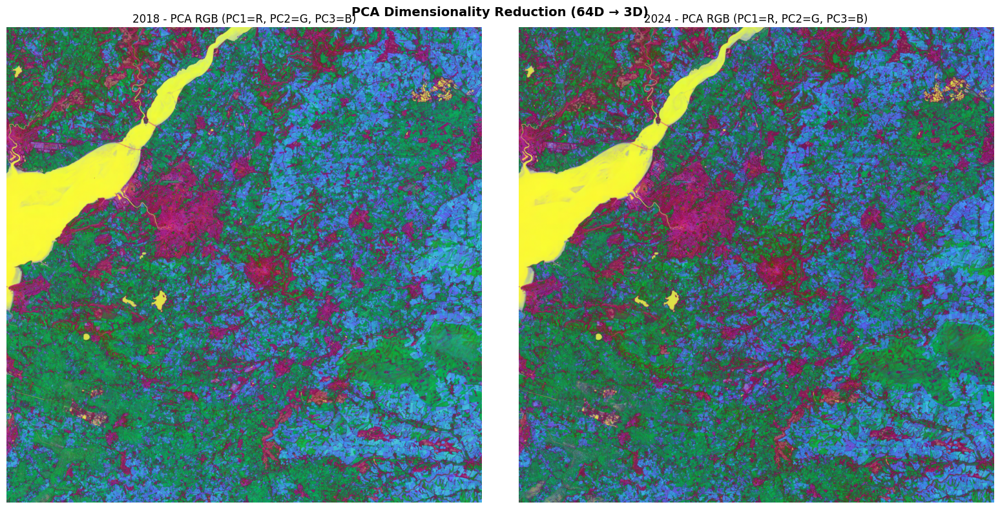

In [24]:
# Transform both years using fitted PCA
def apply_pca_to_image(embeddings, pca_model, valid_mask):
    """Apply PCA and reconstruct as image."""
    h, w, d = embeddings.shape
    flat = embeddings.reshape(-1, d)
    valid_flat = valid_mask.flatten()
    
    # Transform valid pixels
    valid_pixels = flat[valid_flat]
    pca_result = pca_model.transform(valid_pixels)
    
    # Reconstruct image
    pca_image = np.full((h * w, 3), np.nan)
    pca_image[valid_flat] = pca_result
    pca_image = pca_image.reshape(h, w, 3)
    
    # Normalize for display
    pca_rgb = np.zeros_like(pca_image)
    for i in range(3):
        pca_rgb[:, :, i] = normalize_display(pca_image[:, :, i])
    
    return pca_rgb

print("Applying PCA to 2018...")
pca_2018 = apply_pca_to_image(emb_2018, pca, valid_mask)
print("Applying PCA to 2024...")
pca_2024 = apply_pca_to_image(emb_2024, pca, valid_mask)

# Visualize PCA RGB
fig, axes = plt.subplots(1, 2, figsize=(16, 8))

axes[0].imshow(pca_2018)
axes[0].set_title("2018 - PCA RGB (PC1=R, PC2=G, PC3=B)")
axes[0].axis('off')

axes[1].imshow(pca_2024)
axes[1].set_title("2024 - PCA RGB (PC1=R, PC2=G, PC3=B)")
axes[1].axis('off')

plt.suptitle("PCA Dimensionality Reduction (64D → 3D)", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

## 5. K-Means Clustering

Cluster pixels into distinct land cover types based on their embedding vectors. This provides automatic segmentation without labeled training data.

In [25]:
# K-Means clustering
N_CLUSTERS = 10

print(f"Fitting K-Means with {N_CLUSTERS} clusters...")
# Use subsampled data for fitting
kmeans = KMeans(n_clusters=N_CLUSTERS, random_state=42, n_init=10)
kmeans.fit(subsample)

def apply_kmeans_to_image(embeddings, kmeans_model, valid_mask):
    """Apply K-Means clustering and reconstruct as image."""
    h, w, d = embeddings.shape
    flat = embeddings.reshape(-1, d)
    valid_flat = valid_mask.flatten()
    
    # Predict clusters for valid pixels
    valid_pixels = flat[valid_flat]
    labels = kmeans_model.predict(valid_pixels)
    
    # Reconstruct image
    cluster_image = np.full(h * w, np.nan)
    cluster_image[valid_flat] = labels
    cluster_image = cluster_image.reshape(h, w)
    
    return cluster_image

# Apply to both years
print("Applying K-Means to 2018...")
clusters_2018 = apply_kmeans_to_image(emb_2018, kmeans, valid_mask)
print("Applying K-Means to 2024...")
clusters_2024 = apply_kmeans_to_image(emb_2024, kmeans, valid_mask)

Fitting K-Means with 10 clusters...
Applying K-Means to 2018...
Applying K-Means to 2018...
Applying K-Means to 2024...
Applying K-Means to 2024...


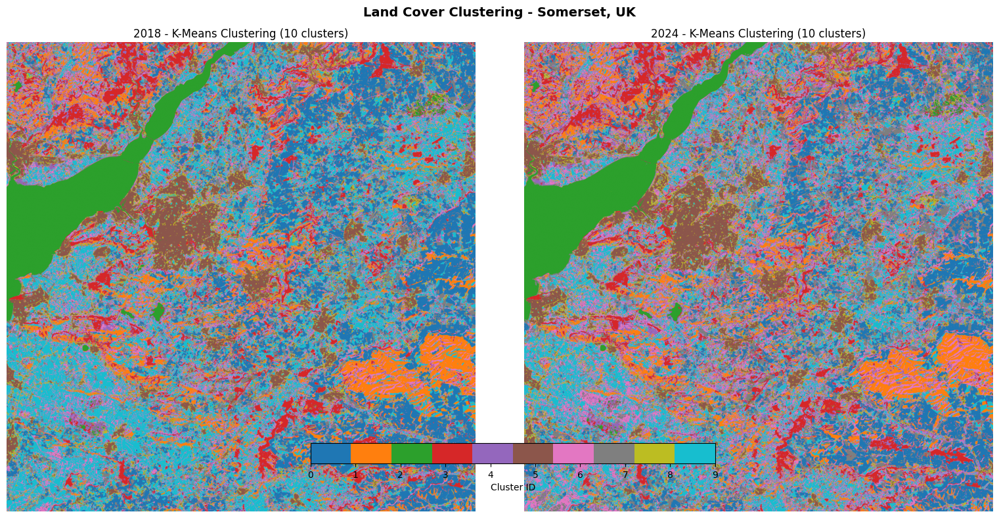

In [26]:
# Visualize clusters
fig, axes = plt.subplots(1, 2, figsize=(16, 8))

# Custom colormap for clusters
cluster_cmap = plt.cm.get_cmap('tab10', N_CLUSTERS)

im1 = axes[0].imshow(clusters_2018, cmap=cluster_cmap, vmin=0, vmax=N_CLUSTERS-1)
axes[0].set_title(f"2018 - K-Means Clustering ({N_CLUSTERS} clusters)")
axes[0].axis('off')

im2 = axes[1].imshow(clusters_2024, cmap=cluster_cmap, vmin=0, vmax=N_CLUSTERS-1)
axes[1].set_title(f"2024 - K-Means Clustering ({N_CLUSTERS} clusters)")
axes[1].axis('off')

# Add colorbar
cbar = plt.colorbar(im2, ax=axes, orientation='horizontal', fraction=0.05, pad=0.05)
cbar.set_label('Cluster ID')
cbar.set_ticks(range(N_CLUSTERS))

plt.suptitle("Land Cover Clustering - Somerset, UK", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

In [27]:
# Analyze cluster distribution changes
print("Cluster Distribution Comparison (2018 vs 2024):")
print("-" * 50)
for i in range(N_CLUSTERS):
    count_2018 = np.nansum(clusters_2018 == i)
    count_2024 = np.nansum(clusters_2024 == i)
    pct_2018 = 100 * count_2018 / valid_mask.sum()
    pct_2024 = 100 * count_2024 / valid_mask.sum()
    change = pct_2024 - pct_2018
    print(f"Cluster {i:2d}: 2018={pct_2018:5.2f}%  2024={pct_2024:5.2f}%  Change={change:+5.2f}%")

Cluster Distribution Comparison (2018 vs 2024):
--------------------------------------------------
Cluster  0: 2018=16.18%  2024=11.53%  Change=-4.65%
Cluster  1: 2018= 8.84%  2024= 8.63%  Change=-0.20%
Cluster  2: 2018= 5.42%  2024= 5.38%  Change=-0.04%
Cluster  3: 2018= 6.41%  2024= 6.10%  Change=-0.31%
Cluster  4: 2018= 6.65%  2024= 9.20%  Change=+2.55%
Cluster  5: 2018= 6.24%  2024= 6.19%  Change=-0.05%
Cluster  6: 2018=13.48%  2024=17.68%  Change=+4.20%
Cluster  7: 2018= 6.94%  2024= 9.66%  Change=+2.72%
Cluster  8: 2018= 6.26%  2024= 6.66%  Change=+0.41%
Cluster  9: 2018=23.59%  2024=18.96%  Change=-4.63%


## 6. Cosine Similarity Search

Find similar pixels across the image by computing cosine similarity from a reference pixel. This is useful for finding areas with similar land cover characteristics.

In [28]:
def compute_similarity_map(embeddings, ref_y, ref_x, valid_mask):
    """
    Compute cosine similarity from a reference pixel to all other pixels.
    """
    h, w, d = embeddings.shape
    
    # Get reference embedding
    ref_embedding = embeddings[ref_y, ref_x, :].reshape(1, -1)
    
    if np.isnan(ref_embedding).any():
        print(f"Warning: Reference pixel ({ref_y}, {ref_x}) contains NaN values")
        return None
    
    # Flatten embeddings
    flat = embeddings.reshape(-1, d)
    valid_flat = valid_mask.flatten()
    valid_pixels = flat[valid_flat]
    
    # Compute cosine similarity
    similarities = cosine_similarity(valid_pixels, ref_embedding).flatten()
    
    # Reconstruct image
    sim_image = np.full(h * w, np.nan)
    sim_image[valid_flat] = similarities
    sim_image = sim_image.reshape(h, w)
    
    return sim_image

# Select reference points - ADJUSTED for downsampled coordinates
# Original coords / DOWNSAMPLE_FACTOR
h, w = emb_2024.shape[:2]
reference_points = [
    (h // 2, w // 2, "Center region"),
    (h // 4, w // 4, "Northwest region"),
    (3 * h // 4, 3 * w // 4, "Southeast region"),
    (h // 2, w // 8, "Western region"),
]

print("Reference points for similarity search:")
for y, x, label in reference_points:
    if y < h and x < w and valid_mask[y, x]:
        cluster = int(clusters_2024[y, x]) if not np.isnan(clusters_2024[y, x]) else "N/A"
        print(f"  ({y}, {x}) - {label} - Cluster: {cluster}")
    else:
        print(f"  ({y}, {x}) - {label} - INVALID (NoData or out of bounds)")

Reference points for similarity search:
  (1024, 1024) - Center region - Cluster: 7
  (512, 512) - Northwest region - Cluster: 2
  (1536, 1536) - Southeast region - Cluster: 0
  (1024, 256) - Western region - Cluster: 6


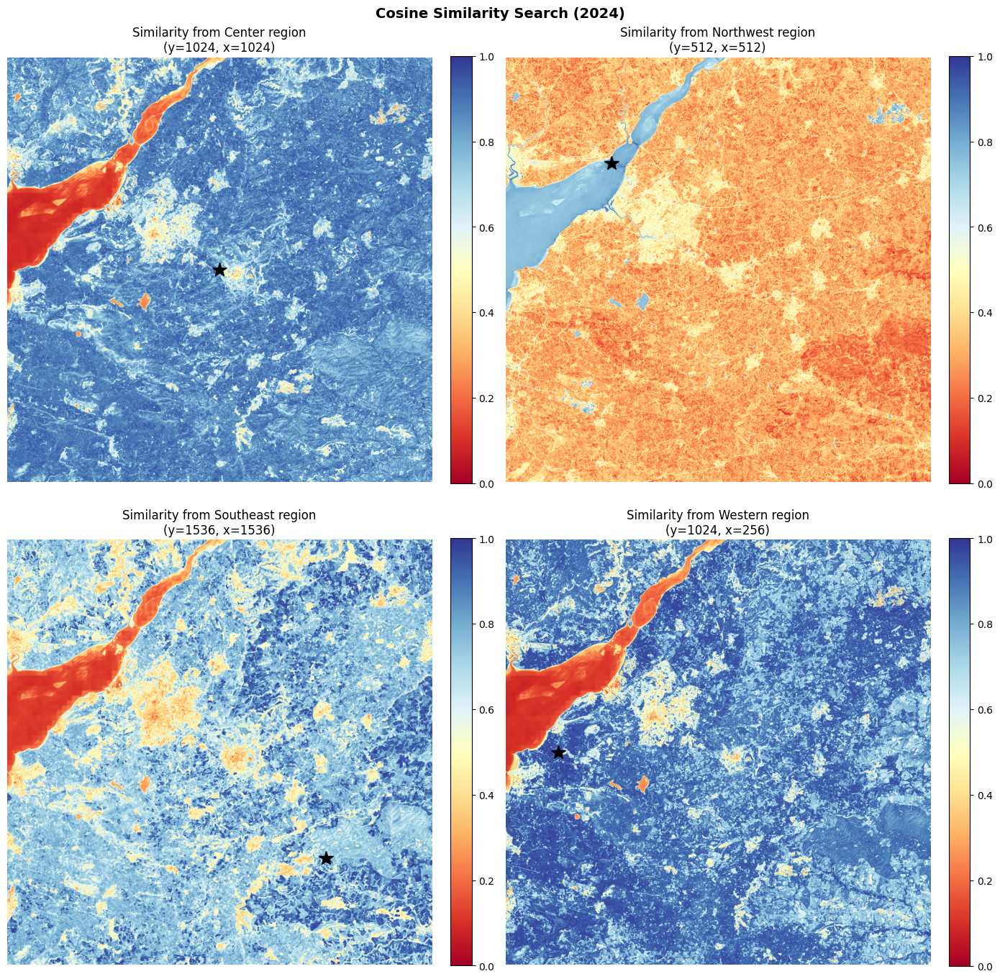

In [29]:
# Compute and visualize similarity maps
fig, axes = plt.subplots(2, 2, figsize=(14, 14))

for idx, (ref_y, ref_x, label) in enumerate(reference_points):
    ax = axes[idx // 2, idx % 2]
    
    if valid_mask[ref_y, ref_x]:
        sim_map = compute_similarity_map(emb_2024, ref_y, ref_x, valid_mask)
        im = ax.imshow(sim_map, cmap='RdYlBu', vmin=0, vmax=1)
        ax.plot(ref_x, ref_y, 'k*', markersize=15)  # Mark reference point
        plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
        ax.set_title(f"Similarity from {label}\n(y={ref_y}, x={ref_x})")
    else:
        ax.text(0.5, 0.5, f"Invalid reference\n{label}", ha='center', va='center', transform=ax.transAxes)
        ax.set_title(f"{label} - Invalid")
    
    ax.axis('off')

plt.suptitle("Cosine Similarity Search (2024)", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

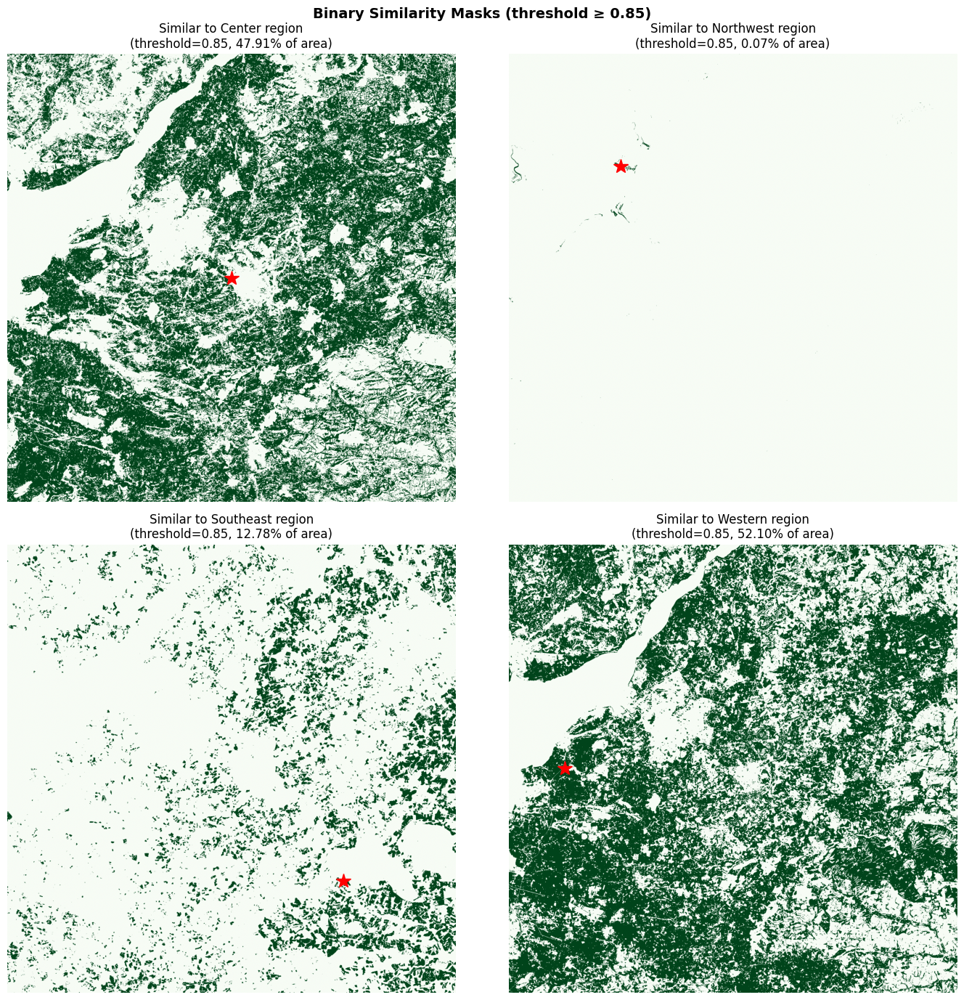

In [30]:
# Create binary masks by thresholding similarity
# This is useful for extracting specific land cover types

SIMILARITY_THRESHOLD = 0.85

fig, axes = plt.subplots(2, 2, figsize=(14, 14))

for idx, (ref_y, ref_x, label) in enumerate(reference_points):
    ax = axes[idx // 2, idx % 2]
    
    if valid_mask[ref_y, ref_x]:
        sim_map = compute_similarity_map(emb_2024, ref_y, ref_x, valid_mask)
        binary_mask = sim_map >= SIMILARITY_THRESHOLD
        ax.imshow(binary_mask, cmap='Greens')
        ax.plot(ref_x, ref_y, 'r*', markersize=15)  # Mark reference point
        pct = 100 * np.nansum(binary_mask) / valid_mask.sum()
        ax.set_title(f"Similar to {label}\n(threshold={SIMILARITY_THRESHOLD}, {pct:.2f}% of area)")
    else:
        ax.text(0.5, 0.5, f"Invalid reference\n{label}", ha='center', va='center', transform=ax.transAxes)
        ax.set_title(f"{label} - Invalid")
    
    ax.axis('off')

plt.suptitle(f"Binary Similarity Masks (threshold ≥ {SIMILARITY_THRESHOLD})", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

## 7. Change Detection (2018 → 2024)

Compare embeddings between 2018 and 2024 to detect landscape changes over the 6-year period. The magnitude of the embedding difference vector indicates how much a pixel has changed.

In [31]:
# Compute change between 2018 and 2024
# Difference vector for each pixel
diff = emb_2024 - emb_2018

# Change magnitude (Euclidean distance in embedding space)
change_magnitude = np.linalg.norm(diff, axis=2)

# Set invalid pixels to NaN
change_magnitude[~valid_mask] = np.nan

# Statistics
print("Change Magnitude Statistics:")
print(f"  Min: {np.nanmin(change_magnitude):.4f}")
print(f"  Max: {np.nanmax(change_magnitude):.4f}")
print(f"  Mean: {np.nanmean(change_magnitude):.4f}")
print(f"  Median: {np.nanmedian(change_magnitude):.4f}")
print(f"  Std: {np.nanstd(change_magnitude):.4f}")

Change Magnitude Statistics:
  Min: 0.0544
  Max: 1.2398
  Mean: 0.2938
  Median: 0.2546
  Std: 0.1387


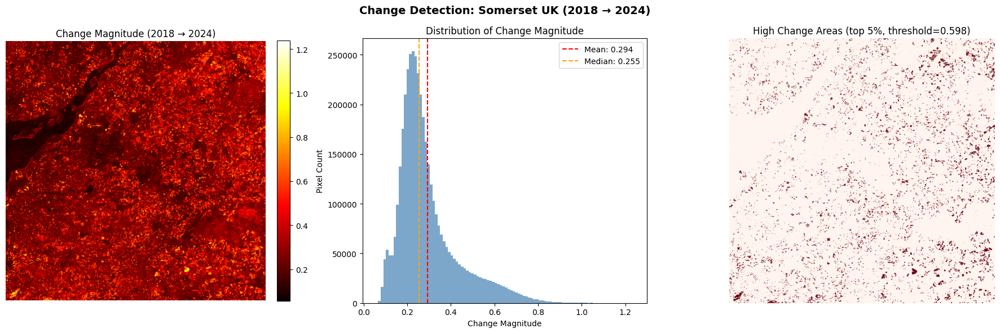

In [32]:
# Visualize change magnitude
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Full change magnitude map
im1 = axes[0].imshow(change_magnitude, cmap='hot')
axes[0].set_title("Change Magnitude (2018 → 2024)")
axes[0].axis('off')
plt.colorbar(im1, ax=axes[0], fraction=0.046, pad=0.04)

# Histogram of change values
valid_changes = change_magnitude[valid_mask]
axes[1].hist(valid_changes, bins=100, color='steelblue', edgecolor='none', alpha=0.7)
axes[1].axvline(np.nanmean(change_magnitude), color='red', linestyle='--', label=f'Mean: {np.nanmean(change_magnitude):.3f}')
axes[1].axvline(np.nanmedian(change_magnitude), color='orange', linestyle='--', label=f'Median: {np.nanmedian(change_magnitude):.3f}')
axes[1].set_xlabel('Change Magnitude')
axes[1].set_ylabel('Pixel Count')
axes[1].set_title('Distribution of Change Magnitude')
axes[1].legend()

# High change areas (top 5%)
threshold_95 = np.nanpercentile(change_magnitude, 95)
high_change = change_magnitude >= threshold_95
axes[2].imshow(high_change, cmap='Reds')
axes[2].set_title(f"High Change Areas (top 5%, threshold={threshold_95:.3f})")
axes[2].axis('off')

plt.suptitle("Change Detection: Somerset UK (2018 → 2024)", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

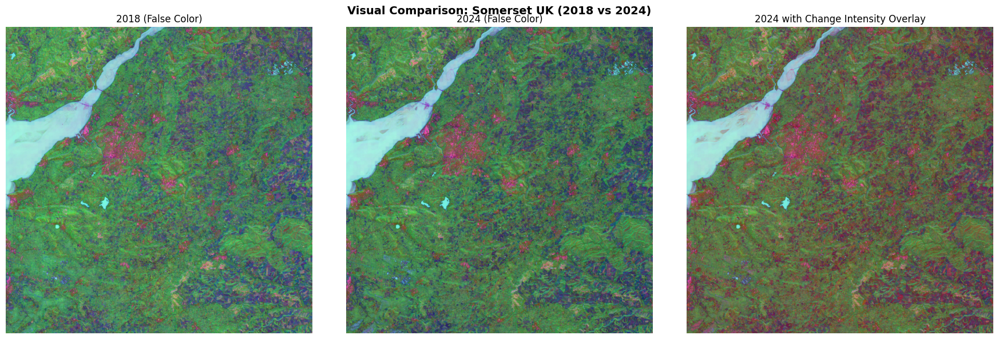

In [33]:
# Side-by-side comparison with change overlay
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# 2018 false color
rgb_2018 = create_false_color(emb_2018, 0, 31, 63)
axes[0].imshow(rgb_2018)
axes[0].set_title("2018 (False Color)")
axes[0].axis('off')

# 2024 false color
rgb_2024 = create_false_color(emb_2024, 0, 31, 63)
axes[1].imshow(rgb_2024)
axes[1].set_title("2024 (False Color)")
axes[1].axis('off')

# Change overlay on 2024
axes[2].imshow(rgb_2024)
# Overlay high change areas in red
change_overlay = np.zeros((*change_magnitude.shape, 4))  # RGBA
change_overlay[:, :, 0] = 1  # Red channel
change_overlay[:, :, 3] = normalize_display(change_magnitude) * 0.6  # Alpha based on change
axes[2].imshow(change_overlay)
axes[2].set_title("2024 with Change Intensity Overlay")
axes[2].axis('off')

plt.suptitle("Visual Comparison: Somerset UK (2018 vs 2024)", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

Top 5 dimensions with highest mean change:
  Dimension 5: 0.0523
  Dimension 32: 0.0518
  Dimension 44: 0.0427
  Dimension 24: 0.0422
  Dimension 34: 0.0410


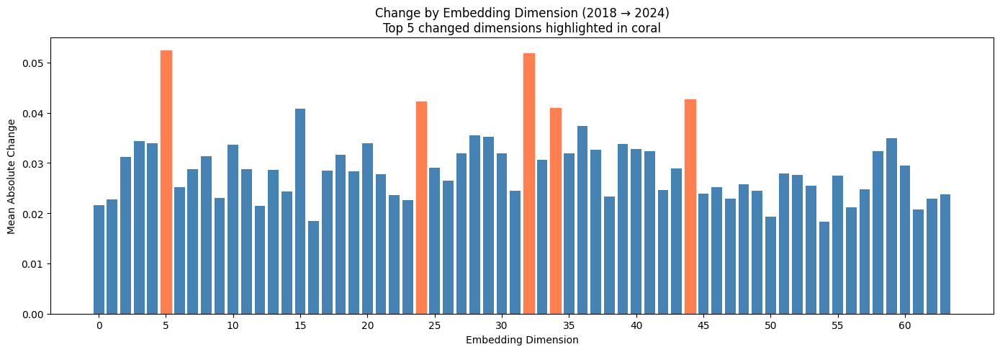

In [34]:
# Analyze which dimensions changed the most
dim_changes = np.abs(diff)
mean_dim_change = np.nanmean(dim_changes, axis=(0, 1))

fig, ax = plt.subplots(figsize=(14, 5))
bars = ax.bar(range(64), mean_dim_change, color='steelblue')

# Highlight top 5 dimensions with most change
top_dims = np.argsort(mean_dim_change)[-5:]
for dim in top_dims:
    bars[dim].set_color('coral')

ax.set_xlabel('Embedding Dimension')
ax.set_ylabel('Mean Absolute Change')
ax.set_title('Change by Embedding Dimension (2018 → 2024)\nTop 5 changed dimensions highlighted in coral')
ax.set_xticks(range(0, 64, 5))

print("Top 5 dimensions with highest mean change:")
for dim in reversed(top_dims):
    print(f"  Dimension {dim}: {mean_dim_change[dim]:.4f}")

plt.tight_layout()
plt.show()

## 8. Interactive Exploration

Use the cells below to explore specific regions or pixels of interest. Modify the coordinates to investigate different areas.

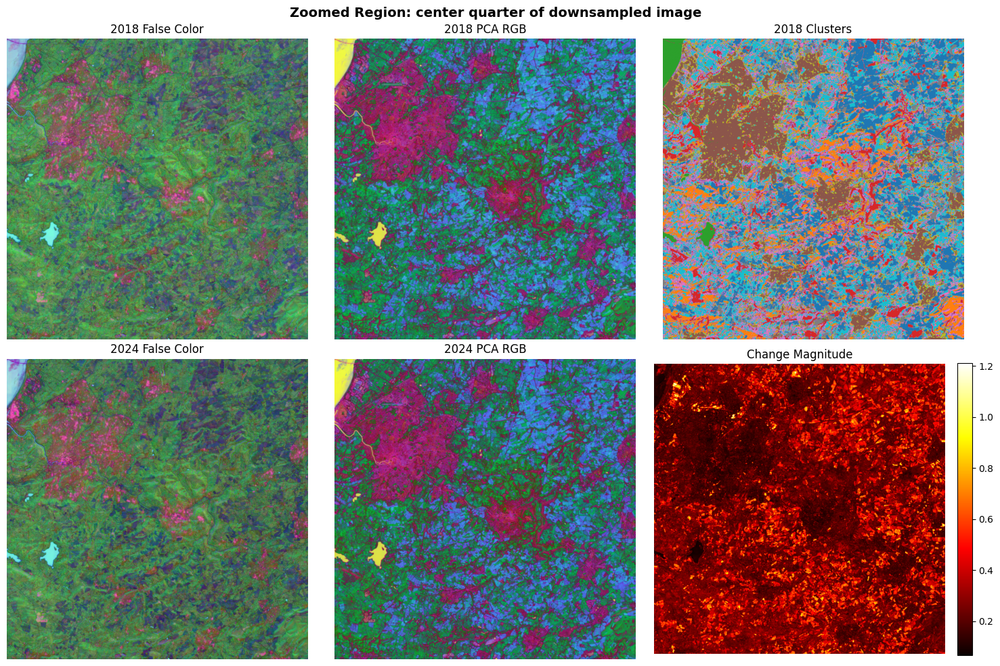

In [35]:
# Zoom into a specific region - ADJUSTED for downsampled data
# Coordinates are now relative to the downsampled image size
h, w = emb_2024.shape[:2]

# Zoom into center quarter of the image
ZOOM_Y_START = h // 4
ZOOM_Y_END = 3 * h // 4
ZOOM_X_START = w // 4
ZOOM_X_END = 3 * w // 4

fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# 2018 false color (zoomed)
axes[0, 0].imshow(rgb_2018[ZOOM_Y_START:ZOOM_Y_END, ZOOM_X_START:ZOOM_X_END])
axes[0, 0].set_title("2018 False Color")
axes[0, 0].axis('off')

# 2018 PCA (zoomed)
axes[0, 1].imshow(pca_2018[ZOOM_Y_START:ZOOM_Y_END, ZOOM_X_START:ZOOM_X_END])
axes[0, 1].set_title("2018 PCA RGB")
axes[0, 1].axis('off')

# 2018 clusters (zoomed)
axes[0, 2].imshow(clusters_2018[ZOOM_Y_START:ZOOM_Y_END, ZOOM_X_START:ZOOM_X_END], cmap=cluster_cmap, vmin=0, vmax=N_CLUSTERS-1)
axes[0, 2].set_title("2018 Clusters")
axes[0, 2].axis('off')

# 2024 false color (zoomed)
axes[1, 0].imshow(rgb_2024[ZOOM_Y_START:ZOOM_Y_END, ZOOM_X_START:ZOOM_X_END])
axes[1, 0].set_title("2024 False Color")
axes[1, 0].axis('off')

# 2024 PCA (zoomed)
axes[1, 1].imshow(pca_2024[ZOOM_Y_START:ZOOM_Y_END, ZOOM_X_START:ZOOM_X_END])
axes[1, 1].set_title("2024 PCA RGB")
axes[1, 1].axis('off')

# Change magnitude (zoomed)
im = axes[1, 2].imshow(change_magnitude[ZOOM_Y_START:ZOOM_Y_END, ZOOM_X_START:ZOOM_X_END], cmap='hot')
axes[1, 2].set_title("Change Magnitude")
axes[1, 2].axis('off')
plt.colorbar(im, ax=axes[1, 2], fraction=0.046, pad=0.04)

plt.suptitle(f"Zoomed Region: center quarter of downsampled image", fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

Pixel (1024, 1024) Summary:
  2018 Cluster: 0
  2024 Cluster: 7
  Change Magnitude: 0.3988
  Cosine Similarity (2018 vs 2024): 0.9200


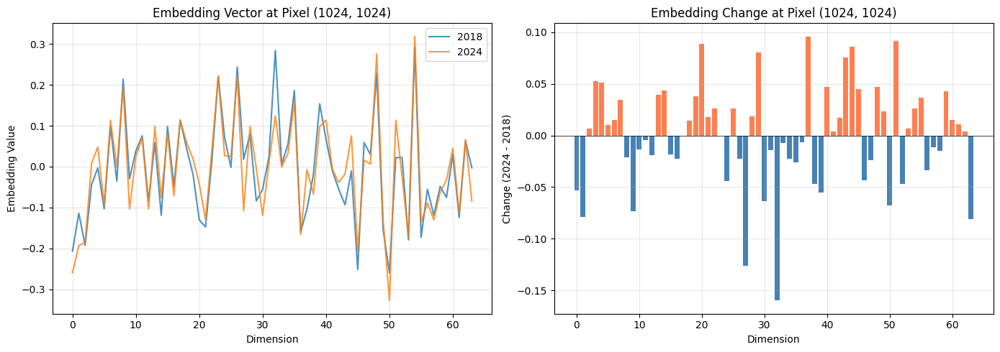

In [36]:
# Investigate a specific pixel - ADJUSTED for downsampled data
h, w = emb_2024.shape[:2]
PIXEL_Y = h // 2  # Center pixel
PIXEL_X = w // 2

if valid_mask[PIXEL_Y, PIXEL_X]:
    fig, axes = plt.subplots(1, 2, figsize=(14, 5))
    
    # Plot embedding vector for 2018 and 2024
    axes[0].plot(emb_2018[PIXEL_Y, PIXEL_X, :], label='2018', alpha=0.8)
    axes[0].plot(emb_2024[PIXEL_Y, PIXEL_X, :], label='2024', alpha=0.8)
    axes[0].set_xlabel('Dimension')
    axes[0].set_ylabel('Embedding Value')
    axes[0].set_title(f'Embedding Vector at Pixel ({PIXEL_Y}, {PIXEL_X})')
    axes[0].legend()
    axes[0].grid(True, alpha=0.3)
    
    # Plot difference
    pixel_diff = emb_2024[PIXEL_Y, PIXEL_X, :] - emb_2018[PIXEL_Y, PIXEL_X, :]
    axes[1].bar(range(64), pixel_diff, color=['coral' if d > 0 else 'steelblue' for d in pixel_diff])
    axes[1].set_xlabel('Dimension')
    axes[1].set_ylabel('Change (2024 - 2018)')
    axes[1].set_title(f'Embedding Change at Pixel ({PIXEL_Y}, {PIXEL_X})')
    axes[1].axhline(0, color='black', linewidth=0.5)
    axes[1].grid(True, alpha=0.3)
    
    # Print summary
    print(f"Pixel ({PIXEL_Y}, {PIXEL_X}) Summary:")
    print(f"  2018 Cluster: {int(clusters_2018[PIXEL_Y, PIXEL_X])}")
    print(f"  2024 Cluster: {int(clusters_2024[PIXEL_Y, PIXEL_X])}")
    print(f"  Change Magnitude: {change_magnitude[PIXEL_Y, PIXEL_X]:.4f}")
    print(f"  Cosine Similarity (2018 vs 2024): {cosine_similarity(emb_2018[PIXEL_Y, PIXEL_X, :].reshape(1,-1), emb_2024[PIXEL_Y, PIXEL_X, :].reshape(1,-1))[0,0]:.4f}")
    
    plt.tight_layout()
    plt.show()
else:
    print(f"Pixel ({PIXEL_Y}, {PIXEL_X}) is invalid (NoData). Choose different coordinates.")

## 9. Interactive Similarity Search Tool

Click anywhere on the image to select a reference point, then use the slider to adjust the cosine similarity threshold. Areas with similarity above the threshold will be highlighted.

In [ ]:
import ipywidgets as widgets
from IPython.display import display, clear_output

class InteractiveSimilarityTool:
    """Interactive tool for exploring similarity in embedding space."""
    
    def __init__(self, embeddings, rgb_image, valid_mask):
        self.embeddings = embeddings
        self.rgb_image = rgb_image
        self.valid_mask = valid_mask
        self.h, self.w = embeddings.shape[:2]
        
        # State
        self.ref_point = None
        self.similarity_map = None
        
        # Create widgets
        self.threshold_slider = widgets.FloatSlider(
            value=0.9,
            min=0.0,
            max=1.0,
            step=0.01,
            description='Similarity:',
            continuous_update=False,
            style={'description_width': 'initial'},
            layout=widgets.Layout(width='400px')
        )
        
        self.output = widgets.Output()
        self.info_output = widgets.Output()
        
        # Connect events
        self.threshold_slider.observe(self._on_threshold_change, names='value')
        
    def _compute_similarity(self, ref_y, ref_x):
        """Compute cosine similarity map from reference point."""
        ref_embedding = self.embeddings[ref_y, ref_x, :]
        
        # Flatten embeddings for batch computation
        flat_emb = self.embeddings.reshape(-1, 64)
        
        # Compute cosine similarity
        ref_norm = np.linalg.norm(ref_embedding)
        flat_norms = np.linalg.norm(flat_emb, axis=1)
        
        # Avoid division by zero
        valid_norms = flat_norms > 0
        similarity = np.zeros(self.h * self.w)
        similarity[valid_norms] = np.dot(flat_emb[valid_norms], ref_embedding) / (flat_norms[valid_norms] * ref_norm)
        
        return similarity.reshape(self.h, self.w)
    
    def _update_display(self):
        """Update the visualization."""
        with self.output:
            clear_output(wait=True)
            
            fig, axes = plt.subplots(1, 3, figsize=(16, 5))
            
            # Left: RGB with reference point
            axes[0].imshow(self.rgb_image)
            axes[0].set_title('Click to Select Reference Point')
            if self.ref_point:
                axes[0].scatter(self.ref_point[1], self.ref_point[0], 
                               c='red', s=100, marker='x', linewidths=3)
                axes[0].set_title(f'Reference: ({self.ref_point[0]}, {self.ref_point[1]})')
            axes[0].axis('off')
            
            # Middle: Similarity map
            if self.similarity_map is not None:
                im = axes[1].imshow(self.similarity_map, cmap='RdYlBu_r', vmin=0, vmax=1)
                plt.colorbar(im, ax=axes[1], fraction=0.046)
                axes[1].set_title('Cosine Similarity')
            else:
                axes[1].imshow(np.zeros((self.h, self.w)), cmap='gray')
                axes[1].set_title('Similarity (select a point)')
            axes[1].axis('off')
            
            # Right: Thresholded mask overlay
            threshold = self.threshold_slider.value
            if self.similarity_map is not None:
                # Create overlay
                overlay = self.rgb_image.copy()
                mask = (self.similarity_map >= threshold) & self.valid_mask
                
                # Highlight similar areas in cyan
                overlay[mask] = overlay[mask] * 0.5 + np.array([0, 1, 1]) * 0.5
                
                # Count similar pixels
                n_similar = np.sum(mask)
                pct_similar = 100 * n_similar / np.sum(self.valid_mask)
                
                axes[2].imshow(overlay)
                axes[2].set_title(f'Similar Areas (>={threshold:.2f})\n{n_similar:,} pixels ({pct_similar:.1f}%)')
            else:
                axes[2].imshow(self.rgb_image)
                axes[2].set_title('Similar Areas (select a point)')
            axes[2].axis('off')
            
            plt.tight_layout()
            plt.show()
    
    def _on_click(self, event):
        """Handle click events on the figure."""
        if event.inaxes is None:
            return
        
        # Get click coordinates
        x, y = int(event.xdata), int(event.ydata)
        
        # Validate coordinates
        if 0 <= y < self.h and 0 <= x < self.w and self.valid_mask[y, x]:
            self.ref_point = (y, x)
            self.similarity_map = self._compute_similarity(y, x)
            
            with self.info_output:
                clear_output(wait=True)
                print(f'Selected reference point: ({y}, {x})')
                print(f'Computing similarity across {np.sum(self.valid_mask):,} valid pixels...')
            
            self._update_display()
    
    def _on_threshold_change(self, change):
        """Handle threshold slider changes."""
        if self.similarity_map is not None:
            self._update_display()
    
    def display(self):
        """Display the interactive tool."""
        # Create figure for click handling
        with self.output:
            clear_output(wait=True)
            fig, axes = plt.subplots(1, 3, figsize=(16, 5))
            
            axes[0].imshow(self.rgb_image)
            axes[0].set_title('Click to Select Reference Point')
            axes[0].axis('off')
            
            axes[1].imshow(np.zeros((self.h, self.w)), cmap='gray')
            axes[1].set_title('Similarity (select a point)')
            axes[1].axis('off')
            
            axes[2].imshow(self.rgb_image)
            axes[2].set_title('Similar Areas (select a point)')
            axes[2].axis('off')
            
            plt.tight_layout()
            
            # Connect click handler
            fig.canvas.mpl_connect('button_press_event', self._on_click)
            
            plt.show()
        
        # Display widgets
        display(widgets.VBox([
            widgets.HTML('<h4>Adjust threshold to filter similar areas:</h4>'),
            self.threshold_slider,
            self.info_output,
            self.output
        ]))

# Create and display the interactive tool
print('Interactive Similarity Search Tool')
print('=' * 40)
print('1. Click on the image to select a reference point')
print('2. Use the slider to adjust the similarity threshold')
print('3. Cyan overlay shows areas with similarity >= threshold')
print()

tool = InteractiveSimilarityTool(emb_2024, rgb_2024, valid_mask)
tool.display()

## Summary

This notebook demonstrated the key analysis techniques for AlphaEarth embeddings:

1. **False Color Visualization** - Quick visual exploration using 3 embedding dimensions as RGB
2. **Individual Dimension Exploration** - Understanding what each dimension encodes
3. **PCA Dimensionality Reduction** - Natural visualization capturing maximum variance
4. **K-Means Clustering** - Automatic land cover segmentation
5. **Cosine Similarity Search** - Finding similar land cover across the image
6. **Change Detection** - Identifying landscape changes over time (2018 → 2024)

### Key Findings for Somerset, UK
- The embedding dimensions capture various landscape features (vegetation, urban, water, etc.)
- Clustering reveals distinct land cover types in the Somerset region
- Change detection highlights areas of development or land use change over 6 years

### Next Steps
- Export high-change areas as GeoTIFF for further GIS analysis
- Correlate clusters with known land cover classifications
- Investigate specific areas of interest in more detail